## Árvores de regressão - exercícios 02

Este exercício será uma continuação do anterior, mesma base, mesmas variáveis - vamos tentar buscar a 'melhor árvore'.


*Atenção - Utilizar a base de dados em anexo que é a mesma base que utilizamos na atividade anterior! A base Boston, assim como para a primeira atividade foi descontinuada e não deve ser utilizada*

In [1]:
from pandas import read_csv, get_dummies
from numpy import number
from seaborn import diverging_palette, clustermap
from graphviz import Source

from sklearn import datasets
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt

df_housing = read_csv('../housing.csv')
df_housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### 1. Execute os passos do exercício anterior, até que você tenha uma árvore de regressão predizendo o valor do imóvel na base de treinamento.

In [2]:
# Separando as variáveis indicadoras
X = df_housing.drop(columns=['median_house_value']).copy()

X = get_dummies(X, drop_first=True)
print(X.info())
X.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   longitude                   20640 non-null  float64
 1   latitude                    20640 non-null  float64
 2   housing_median_age          20640 non-null  float64
 3   total_rooms                 20640 non-null  float64
 4   total_bedrooms              20433 non-null  float64
 5   population                  20640 non-null  float64
 6   households                  20640 non-null  float64
 7   median_income               20640 non-null  float64
 8   ocean_proximity_INLAND      20640 non-null  bool   
 9   ocean_proximity_ISLAND      20640 non-null  bool   
 10  ocean_proximity_NEAR BAY    20640 non-null  bool   
 11  ocean_proximity_NEAR OCEAN  20640 non-null  bool   
dtypes: bool(4), float64(8)
memory usage: 1.3 MB
None


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,False,False,True,False
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,False,False,True,False
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,False,False,True,False
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,False,False,True,False
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,False,False,True,False


In [3]:
# Guardando variavel resposta
y = df_housing.loc[:,'median_house_value']

y.head()

0    452600.0
1    358500.0
2    352100.0
3    341300.0
4    342200.0
Name: median_house_value, dtype: float64

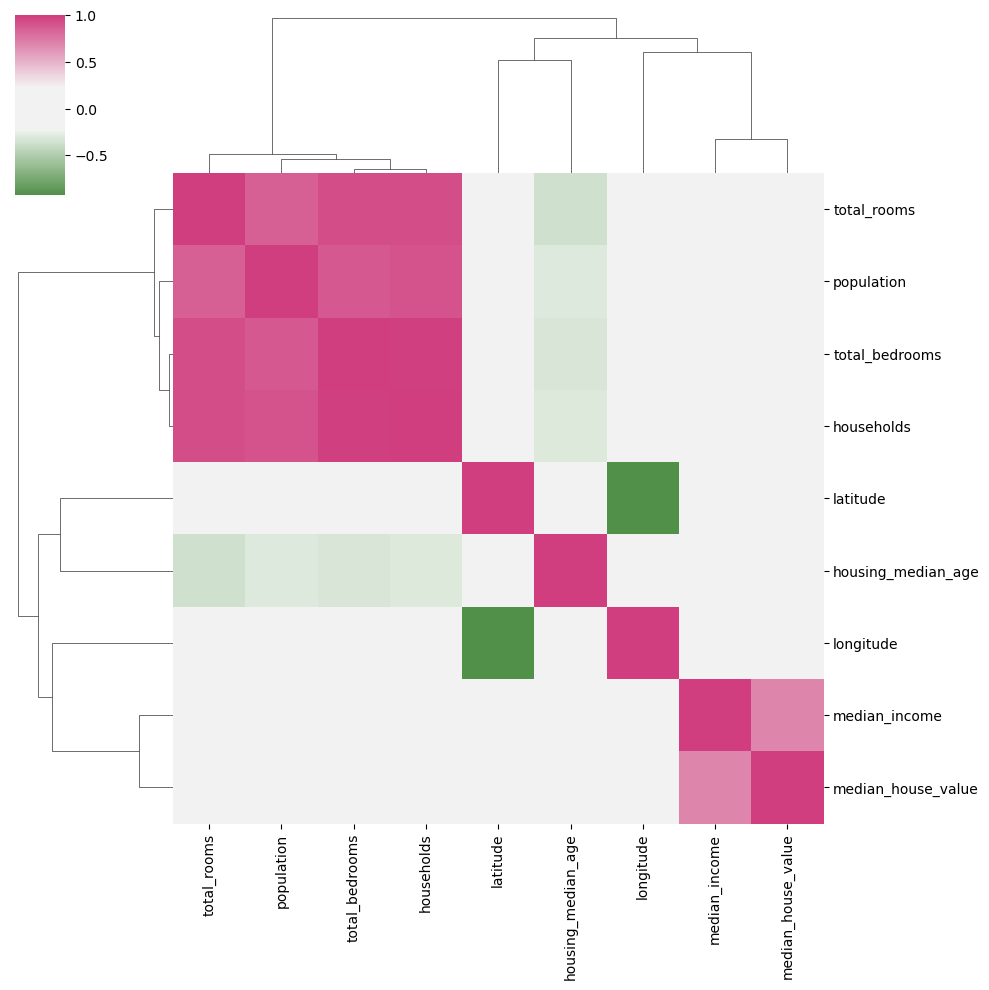

In [4]:
# Calculando a matriz de correlação
correlation_matrix_housing = df_housing.select_dtypes(include=[number]).corr()

# Plotar a clustermap
cmap = diverging_palette(h_neg=125, h_pos=350, as_cmap=True, sep=60, center='light')
clustermap(
    correlation_matrix_housing,
    figsize=(10, 10),
    center=0,
    cmap=cmap,
)

In [5]:
# Separa os dados em treino e test
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=2360873)

In [6]:
# Treinando arvore com profundidade 2 e 8
dtr_2 = DecisionTreeRegressor(max_depth=2)
dtr_8 = DecisionTreeRegressor(max_depth=8)

dtr_2.fit(X_train, y_train)
dtr_8.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=8)

In [7]:
# Realizando predicao
y_pred_reg_2 = dtr_2.predict(X_train)
y_pred_reg_8 = dtr_8.predict(X_train)

In [8]:
# Calculo R2
r2_reg_2 = dtr_2.score(X_train, y_train)
r2_reg_8 = dtr_8.score(X_train, y_train)

print(f'O R2 para profundidade 2 foi: {r2_reg_2:.2f}.')
print(f'O R2 para profundidade 8 foi: {r2_reg_8:.2f}.')

O R2 para profundidade 2 foi: 0.49.
O R2 para profundidade 8 foi: 0.76.


In [9]:
# Calculo MSE
mse_reg_2 = mean_squared_error(y_train, y_pred_reg_2)
mse_reg_8 = mean_squared_error(y_train, y_pred_reg_8)

print(f'O MSE para profundidade 2 foi: {mse_reg_2:.2f}.')
print(f'O MSE para profundidade 8 foi: {mse_reg_8:.2f}.')

O MSE para profundidade 2 foi: 6793591556.61.
O MSE para profundidade 8 foi: 3272116533.99.


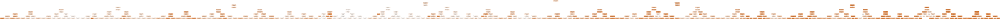

In [10]:
# Visualizando a arvore 2
dot_data = tree.export_graphviz(
    dtr_8,
    out_file=None,
    feature_names=X.columns,
    filled=True
)

# Draw graph
graph = Source(dot_data, format="png") 
graph

### 2.  Calcule o caminho indicado pelos CCP-alfas dessa árvore.

In [11]:
# Calculando o CCP
path = dtr_8.cost_complexity_pruning_path(X_train, y_train)
path

{'ccp_alphas': array([0.00000000e+00, 1.16602067e+02, 2.53229974e+02, 1.20187339e+03,
        9.89179587e+03, 3.73385013e+04, 7.55935078e+04, 8.07525840e+04,
        1.08487229e+05, 1.22806667e+05, 1.52016472e+05, 1.81686047e+05,
        1.94132267e+05, 2.30135926e+05, 2.63958656e+05, 2.69798557e+05,
        2.83581718e+05, 2.97949407e+05, 3.14386648e+05, 3.39115740e+05,
        4.00617733e+05, 4.08793605e+05, 4.34179580e+05, 4.39635372e+05,
        4.63500436e+05, 4.69612724e+05, 4.81443841e+05, 4.81698090e+05,
        5.52448934e+05, 5.83375144e+05, 6.02499887e+05, 6.05349160e+05,
        6.13848002e+05, 6.15339370e+05, 6.26744724e+05, 7.59818923e+05,
        7.72018669e+05, 7.91632935e+05, 8.14389406e+05, 8.20105931e+05,
        8.59595824e+05, 8.69918847e+05, 8.99554054e+05, 9.30581421e+05,
        9.37636300e+05, 9.46328063e+05, 1.00096301e+06, 1.02872389e+06,
        1.10822189e+06, 1.12789519e+06, 1.15872059e+06, 1.16634493e+06,
        1.18848607e+06, 1.19859250e+06, 1.20216146

Text(0, 0.5, 'Impureza total das folhas')

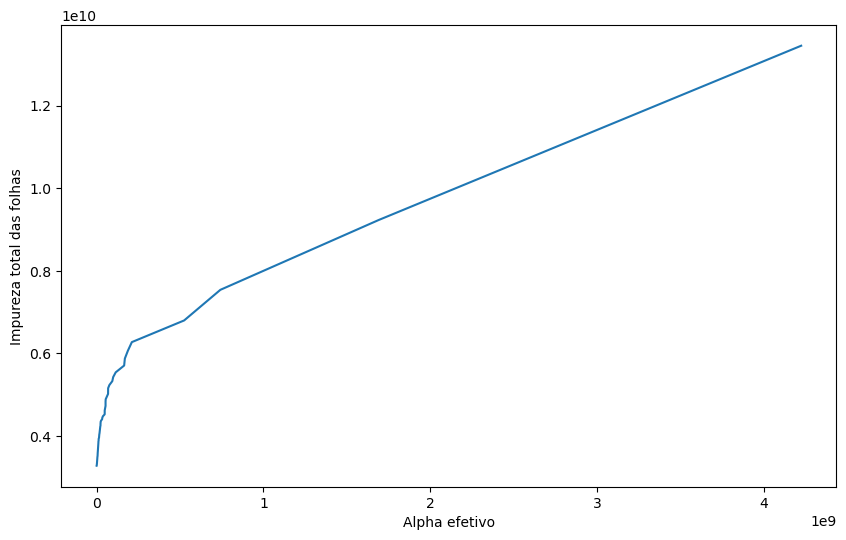

In [12]:
ccp_alphas, impurities = path.ccp_alphas, path.impurities

plt.figure(figsize=(10, 6))
plt.plot(ccp_alphas, impurities)
plt.xlabel("Alpha efetivo")
plt.ylabel("Impureza total das folhas")

### 3. Paca cada valor de alpha obtido no item 2, treine uma árvore com o respectivo alfa, e guarde essa árvore em uma lista.

In [13]:
# Percorrendo os valores de alpha, treinando uma arvore e guardando numa lista
clfs = []

for ccp_alpha in ccp_alphas:
    clf = DecisionTreeRegressor(random_state=0, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs.append(clf)

Text(0, 0.5, 'Profundidade da árvore')

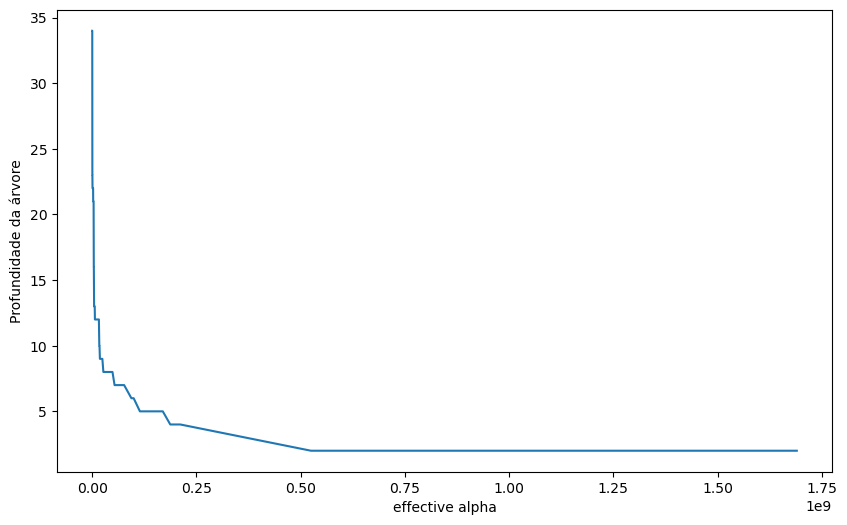

In [14]:
# Plotando os valores da lista
tree_depths = [clf.tree_.max_depth for clf in clfs]
plt.figure(figsize=(10,  6))
plt.plot(ccp_alphas[:-1], tree_depths[:-1])
plt.xlabel("effective alpha")
plt.ylabel("Profundidade da árvore")

### 4. Para cada árvore na lista, calcule o MSE da árvore.

In [15]:
train_scores = [mean_squared_error(y_train , clf.predict(X_train)) for clf in clfs]

### 5. Monte um gráfico do MSE pelo alpha, escolha um valor de alpha perto do ponto de mínimo do MSE

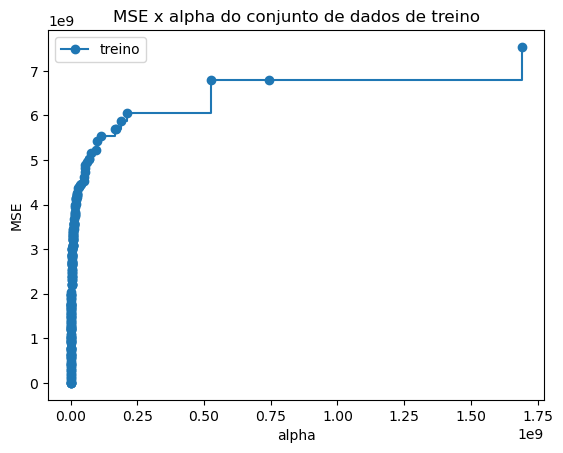

In [16]:
fig, ax = plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("MSE")
ax.set_title("MSE x alpha do conjunto de dados de treino")
ax.plot(
    ccp_alphas[:-1],
    train_scores[:-1],
    marker='o',
    label="treino",
    drawstyle="steps-post"
)
ax.legend()
plt.show()

# 0.25

### 6. Calcule o R-quadrado dessa árvore encontrada no item acima

In [18]:
# Treinando arvore
clf6 = DecisionTreeRegressor(random_state=0, ccp_alpha=0.25)
clf6.fit(X_train, y_train)

# R-quadrado
rq = clf6.score(X_train, y_train)
print(f'R-quadrado: {rq: .2f}')

R-quadrado:  1.00


### 7. Visualize esta árvore.

In [20]:
# Visualizando a clf6
dot_data_clf6 = tree.export_graphviz(
    clf6,
    out_file=None,
    feature_names=X.columns,
    filled=True
)

# Draw graph
graph = Source(dot_data_clf6, format="png") 
graph